# Object Detection using TAO DetectNet_v2

Transfer learning is the process of transferring learned features from one application to another. It is a commonly used training technique where you use a model trained on one task and re-train to use it on a different task. 

Train Adapt Optimize (TAO) Toolkit  is a simple and easy-to-use Python based AI toolkit for taking purpose-built AI models and customizing them with users' own data.

<img align="center" src="https://d29g4g2dyqv443.cloudfront.net/sites/default/files/akamai/TAO/tlt-tao-toolkit-bring-your-own-model-diagram.png" width="1080"> 

## What is DetectNet-V2?

DetectNet_v2, also known as GridBox object detection, is a highly optimized CNN based object detection model, that does bounding-box regression over a uniform grid on the input image. The gridbox system divides an input image into a uniform grid that predicts four normalized bounding-box parameters (xc, yc, w, h) and confidence value per output class.

The raw normalized bounding-box and confidence detection are thesholded and then post-processed by a clustering algorithm such as DBSCAN, NMS or a HYBRID (DBSCAN + NMS) to produce the final bounding-box coordinates and category labels.

### Sample output predictions from a trained DetectNet_v2 model

<img align="center" src="https://miro.medium.com/v2/resize:fit:720/0*YaQDIKR4gRbP2-by" width="960">

<img align="center" src="https://miro.medium.com/v2/resize:fit:720/0*eY1qluSyldYl9qDw" width="960">

## Learning Objectives
In this notebook, you will learn how to leverage the simplicity and convenience of TAO to:

* Take a pretrained resnet18 model and train a ResNet-18 DetectNet_v2 model on the KITTI dataset
* Prune the trained detectnet_v2 model
* Retrain the pruned model to recover lost accuracy
* Export the pruned model
* Quantize the pruned model using QAT
* Run Inference on the trained model
* Export the pruned, quantized and retrained model to a .onnx file for deployment to DeepStream
* Run inference on the exported. etlt model to verify deployment using TensorRT

At the end of this notebook, you will have a trained and optimized `detectnet_v2` model that you
may deploy via [Triton](https://github.com/NVIDIA-AI-IOT/tao-toolkit-triton-apps) or [DeepStream](https://developer.nvidia.com/deepstream-sdk).

### Table of Contents

This notebook shows an example usecase of Object Detection using DetectNet_v2 in the Train Adapt Optimize (TAO) Toolkit.

0. [Set up env variables and map drives](#head-0)
    1. [Third Party MLOPS integration](#head-0-1)
1. [Install the TAO Launcher](#head-1)
1. [Prepare dataset and pre-trained model](#head-2)
    1. [Download the dataset](#head-2-1)
    1. [Verify downloaded dataset](#head-2-2)
    1. [Prepare tfrecords from kitti format dataset](#head-2-3)
    2. [Download pre-trained model](#head-2-4)
2. [Provide training specification](#head-3)
3. [Run TAO training](#head-4)
4. [Evaluate trained models](#head-5)
5. [Prune trained models](#head-6)
6. [Retrain pruned models](#head-7)
7. [Evaluate retrained model](#head-8)
8. [Visualize inferences](#head-9)
9. [Model Export](#head-10)
10. [Verify Deployed Model](#head-11)
    1. [Inference using TensorRT engine](#head-11-1)
11. [QAT workflow](#head-12)
    1. [Convert pruned model to QAT and retrain](#head-12-1)
    2. [Evaluate QAT converted model](#head-12-2)
    3. [Export QAT trained model to int8](#head-12-3)
    4. [Evaluate a QAT trained model using the exported TensorRT engine](#head-12-4)
    5. [Inference using QAT engine](#head-12-5)

## 0. Set up env variables and map drives <a class="anchor" id="head-0"></a>

The following notebook requires the user to set an env variable called the `$LOCAL_PROJECT_DIR` as the path to the users workspace. Please note that the dataset to run this notebook is expected to reside in the `$LOCAL_PROJECT_DIR/data`, while the TAO experiment generated collaterals will be output to `$LOCAL_PROJECT_DIR/detectnet_v2`. More information on how to set up the dataset and the supported steps in the TAO workflow are provided in the subsequent cells.

*Note: Please make sure to remove any stray artifacts/files from the `$USER_EXPERIMENT_DIR` or `$DATA_DOWNLOAD_DIR` paths as mentioned below, that may have been generated from previous experiments. Having checkpoint files etc may interfere with creating a training graph for a new experiment.*

*Note: This notebook currently is by default set up to run training using 1 GPU. To use more GPU's please update the env variable `$NUM_GPUS` accordingly*

In [27]:
# Setting up env variables for cleaner command line commands.
import os

%env NUM_GPUS=1
%env USER_EXPERIMENT_DIR=/home/agung/latihan/tao-toolkit/getting_started_v5.3.0/notebooks/tao_launcher_starter_kit/detectnet_v2
%env DATA_DOWNLOAD_DIR=/home/agung/latihan/tao-toolkit/getting_started_v5.3.0/notebooks/tao_launcher_starter_kit/data
%env DOCKER_DATA_DOWNLOAD_DIR=/workspace/getting_started_v5.3.0/notebooks/tao_launcher_starter_kit/data
%env DOCKER_USER_EXPERIMENT_DIR=/workspace/getting_started_v5.3.0/notebooks/tao_launcher_starter_kit/detectnet_v2

# Set this path if you don't run the notebook from the samples directory.
# %env NOTEBOOK_ROOT=~/tao-samples/detectnet_v2

# Please define this local project directory that needs to be mapped to the TAO docker session.
# The dataset expected to be present in $LOCAL_PROJECT_DIR/data, while the results for the steps
# in this notebook will be stored at $LOCAL_PROJECT_DIR/detectnet_v2
# !PLEASE MAKE SURE TO UPDATE THIS PATH!.

os.environ["LOCAL_PROJECT_DIR"] = "/home/agung/latihan/tao-toolkit/getting_started_v5.3.0/notebooks/tao_launcher_starter_kit"
os.environ["LOCAL_DOCKER_PROJECT_DIR"] = "/workspace/getting_started_v5.3.0/notebooks/tao_launcher_starter_kit"

os.environ["LOCAL_DATA_DIR"] = os.path.join(
    os.getenv("LOCAL_PROJECT_DIR", os.getcwd()),
    "data"
)

os.environ["LOCAL_DOCKER_DATA_DIR"] = os.path.join(
    os.getenv("LOCAL_DOCKER_PROJECT_DIR", os.getcwd()),
    "data"
)

os.environ["LOCAL_EXPERIMENT_DIR"] = os.path.join(
    os.getenv("LOCAL_PROJECT_DIR", os.getcwd()),
    "detectnet_v2"
)

os.environ["LOCAL_DOCKER_EXPERIMENT_DIR"] = os.path.join(
    os.getenv("LOCAL_DOCKER_PROJECT_DIR", os.getcwd()),
    "detectnet_v2"
)

# Make the experiment directory 
! mkdir -p $LOCAL_EXPERIMENT_DIR

# The sample spec files are present in the same path as the downloaded samples.
os.environ["LOCAL_SPECS_DIR"] = os.path.join(
    os.getenv("NOTEBOOK_ROOT", os.getcwd()),
    "specs"
)
%env SPECS_DIR=/home/agung/latihan/tao-toolkit/getting_started_v5.3.0/notebooks/tao_launcher_starter_kit/detectnet_v2/specs
CLEARML_LOGGED_IN = False
WANDB_LOGGED_IN = False

# Showing list of specification files.
!ls -rlt $LOCAL_SPECS_DIR

env: NUM_GPUS=1
env: USER_EXPERIMENT_DIR=/home/agung/latihan/tao-toolkit/getting_started_v5.3.0/notebooks/tao_launcher_starter_kit/detectnet_v2
env: DATA_DOWNLOAD_DIR=/home/agung/latihan/tao-toolkit/getting_started_v5.3.0/notebooks/tao_launcher_starter_kit/data
env: DOCKER_DATA_DOWNLOAD_DIR=/workspace/getting_started_v5.3.0/notebooks/tao_launcher_starter_kit/data
env: DOCKER_USER_EXPERIMENT_DIR=/workspace/getting_started_v5.3.0/notebooks/tao_launcher_starter_kit/detectnet_v2
env: SPECS_DIR=/home/agung/latihan/tao-toolkit/getting_started_v5.3.0/notebooks/tao_launcher_starter_kit/detectnet_v2/specs
total 40
-rw-rw-r-- 1 1002 1002 6360 Apr  5 23:58 detectnet_v2_train_resnet18_kitti.txt
-rw-rw-r-- 1 1002 1002  310 Apr  5 23:58 detectnet_v2_tfrecords_kitti_trainval.txt
-rw-rw-r-- 1 1002 1002 6474 Apr  5 23:58 detectnet_v2_retrain_resnet18_kitti_qat.txt
-rw-rw-r-- 1 1002 1002 6375 Apr  5 23:58 detectnet_v2_retrain_resnet18_kitti.txt
-rw-rw-r-- 1 1002 1002 2395 Apr  5 23:58 detectnet_v2_infer

### A. Third Party MLOPS integration <a class="anchor" id="head-0-1"></a>

In [14]:
# Uncomment this code block to enable wandb integration with TAO.
# # you can get the wandb api key by logging into https://wandb.ai
# !pip install wandb

# os.environ["WANDB_API_KEY"] = FIXME
# import wandb
# WANDB_LOGGED_IN = wandb.login()
# if WANDB_LOGGED_IN:
#     print("WANDB successfully logged in.")

In [15]:
# Uncomment the code block in this cell to enable clearml integration with TAO.
# !pip3 install clearml

# # Copy the data from the clearml website when generating credentials through the clearml webapp.
# # Please choose the jupyter notebook tab under the clearml credentials and copy the data as is
# # or fill the values to the required env variables.

# os.environ["CLEARML_WEB_HOST"] = FIXME
# os.environ["CLEARML_API_HOST"] = FIXME
# os.environ["CLEARML_FILES_HOST"] = FIXME
# os.environ["CLEARML_API_ACCESS_KEY"] = FIXME
# os.environ["CLEARML_API_SECRET_KEY"] = FIXME

# CLEARML_LOGGED_IN=True

The cell below maps the project directory on your local host to a workspace directory in the TAO docker instance, so that the data and the results are mapped from in and out of the docker. For more information please refer to the [launcher instance](https://docs.nvidia.com/tao/tao-toolkit/text/tao_launcher.html) in the user guide.

When running this cell on AWS, update the drive_map entry with the dictionary defined below, so that you don't have permission issues when writing data into folders created by the TAO docker.

```json
drive_map = {
    "Mounts": [
            # Mapping the data directory
            {
                "source": os.environ["LOCAL_PROJECT_DIR"],
                "destination": "/workspace/tao-experiments"
            },
            # Mapping the specs directory.
            {
                "source": os.environ["LOCAL_SPECS_DIR"],
                "destination": os.environ["SPECS_DIR"]
            },
        ],
    "DockerOptions": {
        "user": "{}:{}".format(os.getuid(), os.getgid())
    }
}
```

In [17]:
# Mapping up the local directories to the TAO docker.
import json
mounts_file = os.path.expanduser("~/.tao_mounts.json")

# Define the dictionary with the mapped drives
drive_map = {
    "Mounts": [
        # Mapping the data directory
        {
            "source": os.environ["LOCAL_PROJECT_DIR"],
            "destination": "/workspace/tao-experiments"
        },
        # Mapping the specs directory.
        {
            "source": os.environ["SPECS_DIR"],
            "destination": os.environ["LOCAL_SPECS_DIR"]
        },
    ],
    "DockerOptions":{
        "user": f"{os.getuid()}:{os.getgid()}"
    }
}

if CLEARML_LOGGED_IN:
    if "Envs" not in drive_map.keys():
        drive_map["Envs"] = []
    drive_map["Envs"].extend([
        {
            "variable": "CLEARML_WEB_HOST",
            "value": os.getenv("CLEARML_WEB_HOST")
        },
        {
            "variable": "CLEARML_API_HOST",
            "value": os.getenv("CLEARML_API_HOST")
        },
        {
            "variable": "CLEARML_FILES_HOST",
            "value": os.getenv("CLEARML_FILES_HOST")
        },
        {
            "variable": "CLEARML_API_ACCESS_KEY",
            "value": os.getenv("CLEARML_API_ACCESS_KEY")
        },
        {
            "variable": "CLEARML_API_SECRET_KEY",
            "value": os.getenv("CLEARML_API_SECRET_KEY")
        },
    ])

if WANDB_LOGGED_IN:
    if "Envs" not in drive_map.keys():
        drive_map["Envs"] = []
    # Weights and biases currently requires access to the
    # /.config directory in the docker. Therefore, the docker
    # must be instantiated as root user. With the cells mentioned below
    # we will be deleting the cells that set user roles.
    if "user" in drive_map["DockerOptions"].keys():
        del(drive_map["DockerOptions"]["user"])
    drive_map["Envs"].extend([
        {
            "variable": "WANDB_API_KEY",
            "value": os.getenv("WANDB_API_KEY")
        }
    ])

# Writing the mounts file.
with open(mounts_file, "w") as mfile:
    json.dump(drive_map, mfile, indent=4)


In [18]:
!cat ~/.tao_mounts.json

{
    "Mounts": [
        {
            "source": "/home/agung/latihan/tao-toolkit/getting_started_v5.3.0/notebooks/tao_launcher_starter_kit",
            "destination": "/workspace/tao-experiments"
        },
        {
            "source": "/home/agung/latihan/tao-toolkit/getting_started_v5.3.0/notebooks/tao_launcher_starter_kit/detectnet_v2/specs",
            "destination": "/workspace/getting_started_v5.3.0/notebooks/tao_launcher_starter_kit/detectnet_v2/specs"
        }
    ],
    "DockerOptions": {
        "user": "0:0"
    }
}

## 1. Install the TAO launcher <a class="anchor" id="head-1"></a>
The TAO launcher is a python package distributed as a python wheel listed in PyPI. You may install the launcher by executing the following cell.

Please note that TAO Toolkit recommends users to run the TAO launcher in a virtual env with python 3.6.9. You may follow the instruction in this [page](https://virtualenvwrapper.readthedocs.io/en/latest/install.html) to set up a python virtual env using the `virtualenv` and `virtualenvwrapper` packages. Once you have setup virtualenvwrapper, please set the version of python to be used in the virtual env by using the `VIRTUALENVWRAPPER_PYTHON` variable. You may do so by running

```sh
export VIRTUALENVWRAPPER_PYTHON=/path/to/bin/python3.x
```
where x >= 6 and <= 8

We recommend performing this step first and then launching the notebook from the virtual environment. In addition to installing TAO python package, please make sure of the following software requirements:
* python >=3.7, <=3.10.x
* docker-ce > 19.03.5
* docker-API 1.40
* nvidia-container-toolkit > 1.3.0-1
* nvidia-container-runtime > 3.4.0-1
* nvidia-docker2 > 2.5.0-1
* nvidia-driver > 455+

Once you have installed the pre-requisites, please log in to the docker registry nvcr.io by following the command below

```sh
docker login nvcr.io
```

You will be triggered to enter a username and password. The username is `$oauthtoken` and the password is the API key generated from `ngc.nvidia.com`. Please follow the instructions in the [NGC setup guide](https://docs.nvidia.com/ngc/ngc-overview/index.html#generating-api-key) to generate your own API key.

In [19]:
# SKIP this step IF you have already installed the TAO launcher wheel.
!pip3 install nvidia-tao

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.8/58.8 kB 262.5 kB/s eta 0:00:00a 0:00:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.6/62.6 kB 149.9 kB/s eta 0:00:00a 0:00:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 240.7/240.7 kB 50.2 kB/s eta 0:00:00a 0:00:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 133.4/133.4 kB 22.3 kB/s eta 0:00:00a 0:00:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 200.9/200.9 kB 22.7 kB/s eta 0:00:00a 0:00:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 145.2/145.2 kB 26.5 kB/s eta 0:00:0000:0100:01
  Attempting uninstall: six
    Found existing installation: six 1.16.0
    Uninstalling six-1.16.0:
      Successfully uninstalled six-1.16.0
  Attempting uninstall: idna
    Found existing installation: idna 3.4
    Uninstalling idna-3.4:
      Successfully uninstalled idna-3.4
  Attempting uninstall: requests
    Found existing installation: requests 2.28.2
    Uninstalling requests-2.28.2:
      Successfully uninstalled requests-2.28.2


In [20]:
# View the versions of the TAO launcher
!tao info --verbose

Configuration of the TAO Toolkit Instance

task_group:         
    model:             
        dockers:                 
            nvidia/tao/tao-toolkit:                     
                5.0.0-tf2.11.0:                         
                    docker_registry: nvcr.io
                    tasks: 
                        1. classification_tf2
                        2. efficientdet_tf2
                5.0.0-tf1.15.5:                         
                    docker_registry: nvcr.io
                    tasks: 
                        1. bpnet
                        2. classification_tf1
                        3. converter
                        4. detectnet_v2
                        5. dssd
                        6. efficientdet_tf1
                        7. faster_rcnn
                        8. fpenet
                        9. lprnet
                        10. mask_rcnn
                        11. multitask_classification
                        12. retinanet
   

## 2. Prepare dataset and pre-trained model <a class="anchor" id="head-2"></a>

We will be using the kitti object detection dataset for this example. To find more details, please visit http://www.cvlibs.net/datasets/kitti/eval_object.php?obj_benchmark=2d. Please download both, the left color images of the object dataset from [here](http://www.cvlibs.net/download.php?file=data_object_image_2.zip) and, the training labels for the object dataset from [here](http://www.cvlibs.net/download.php?file=data_object_label_2.zip), and place the zip files in `$LOCAL_DATA_DIR`

The data will then be extracted to have
* training images in `$LOCAL_DATA_DIR/training/image_2`
* training labels in `$LOCAL_DATA_DIR/training/label_2`
* testing images in `$LOCAL_DATA_DIR/testing/image_2`

You may use this notebook with your own dataset as well. To use this example with your own dataset, please follow the same directory structure as mentioned below.

*Note: There are no labels for the testing images, therefore we use it just to visualize inferences for the trained model.*

### A. Download the dataset <a class="anchor" id="head-2-1"></a>
Once you have gotten the download links in your email, please populate them in place of the `KITTI_IMAGES_DOWNLOAD_URL` and the `KITTI_LABELS_DOWNLOAD_URL`. This next cell, will download the data and place in `$LOCAL_DATA_DIR`

In [21]:
import os
!mkdir -p $LOCAL_DATA_DIR
os.environ["URL_IMAGES"]=KITTI_IMAGES_DOWNLOAD_URL
!if [ ! -f $LOCAL_DATA_DIR/data_object_image_2.zip ]; then wget $URL_IMAGES -O $LOCAL_DATA_DIR/data_object_image_2.zip; else echo "image archive already downloaded"; fi 
os.environ["URL_LABELS"]=KITTI_LABELS_DOWNLOAD_URL
!if [ ! -f $LOCAL_DATA_DIR/data_object_label_2.zip ]; then wget $URL_LABELS -O $LOCAL_DATA_DIR/data_object_label_2.zip; else echo "label archive already downloaded"; fi 

NameError: name 'KITTI_IMAGES_DOWNLOAD_URL' is not defined

### B. Verify downloaded dataset <a class="anchor" id="head-2-2"></a>

In [ ]:
# Check the dataset is present
!if [ ! -f $LOCAL_DATA_DIR/data_object_image_2.zip ]; then echo 'Image zip file not found, please download.'; else echo 'Found Image zip file.';fi
!if [ ! -f $LOCAL_DATA_DIR/data_object_label_2.zip ]; then echo 'Label zip file not found, please download.'; else echo 'Found Labels zip file.';fi

In [ ]:
# This may take a while: verify integrity of zip files 
!sha256sum $LOCAL_DATA_DIR/data_object_image_2.zip | cut -d ' ' -f 1 | grep -xq '^351c5a2aa0cd9238b50174a3a62b846bc5855da256b82a196431d60ff8d43617$' ; \
if test $? -eq 0; then echo "images OK"; else echo "images corrupt, redownload!" && rm -f $LOCAL_DATA_DIR/data_object_image_2.zip; fi 
!sha256sum $LOCAL_DATA_DIR/data_object_label_2.zip | cut -d ' ' -f 1 | grep -xq '^4efc76220d867e1c31bb980bbf8cbc02599f02a9cb4350effa98dbb04aaed880$' ; \
if test $? -eq 0; then echo "labels OK"; else echo "labels corrupt, redownload!" && rm -f $LOCAL_DATA_DIR/data_object_label_2.zip; fi 

In [ ]:
# unpack downloaded datasets to $DATA_DOWNLOAD_DIR.
# The training images will be under $DATA_DOWNLOAD_DIR/training/image_2 and 
# labels will be under $DATA_DOWNLOAD_DIR/training/label_2.
# The testing images will be under $DATA_DOWNLOAD_DIR/testing/image_2.
!unzip -u $LOCAL_DATA_DIR/data_object_image_2.zip -d $LOCAL_DATA_DIR
!unzip -u $LOCAL_DATA_DIR/data_object_label_2.zip -d $LOCAL_DATA_DIR

In [24]:
# verify
import os

DATA_DIR = os.environ.get('LOCAL_DOCKER_DATA_DIR')
num_training_images = len(os.listdir(os.path.join(DATA_DIR, "training/image_2")))
num_training_labels = len(os.listdir(os.path.join(DATA_DIR, "training/label_2")))
num_testing_images = len(os.listdir(os.path.join(DATA_DIR, "testing/image_2")))
print("Number of images in the train/val set. {}".format(num_training_images))
print("Number of labels in the train/val set. {}".format(num_training_labels))
print("Number of images in the test set. {}".format(num_testing_images))

Number of images in the train/val set. 7481
Number of labels in the train/val set. 7481
Number of images in the test set. 7518


### C. Prepare tf records from kitti format dataset <a class="anchor" id="head-2-3"></a>

* Update the tfrecords spec file to take in your kitti format dataset
* Create the tfrecords using the detectnet_v2 dataset_convert 

*Note: TfRecords only need to be generated once.*

In [25]:
print("TFrecords conversion spec file for kitti training")
!cat $LOCAL_SPECS_DIR/detectnet_v2_tfrecords_kitti_trainval.txt

TFrecords conversion spec file for kitti training
kitti_config {
  root_directory_path: "/workspace/tao-experiments/data/training"
  image_dir_name: "image_2"
  label_dir_name: "label_2"
  image_extension: ".png"
  partition_mode: "random"
  num_partitions: 2
  val_split: 14
  num_shards: 10
}
image_directory_path: "/workspace/tao-experiments/data/training"


In [33]:
# Creating a new directory for the output tfrecords dump.
%env DOCKER_REGISTRY=nvcr.io
%env DOCKER_NAME=nvidia/tao/tao-toolkit
%env DOCKER_TAG=5.0.0-tf1.15.5
# %env DOCKER_CONTAINER=$DOCKER_REGISTRY/$DOCKER_NAME:$DOCKER_TAG
os.environ["DOCKER_CONTAINER"] = os.environ["DOCKER_REGISTRY"]+"/"+os.environ["DOCKER_NAME"]+":"+os.environ["DOCKER_TAG"]
print("Converting Tfrecords for kitti trainval dataset")
!mkdir -p $LOCAL_DATA_DIR/tfrecords && rm -rf $LOCAL_DATA_DIR/tfrecords/*

!docker run -it --rm --gpus device=3 -v /home/agung/latihan/tao-toolkit:/workspace $DOCKER_CONTAINER detectnet_v2 dataset_convert \
                  -d $LOCAL_SPECS_DIR/detectnet_v2_tfrecords_kitti_trainval.txt \
                  -o $DOCKER_DATA_DOWNLOAD_DIR/tfrecords/kitti_trainval/kitti_trainval \
                  -r $DOCKER_USER_EXPERIMENT_DIR/
    
# !tao model detectnet_v2 dataset_convert \
#                   -d $LOCAL_SPECS_DIR/detectnet_v2_tfrecords_kitti_trainval.txt \
#                   -o $DATA_DOWNLOAD_DIR/tfrecords/kitti_trainval/kitti_trainval \
#                   -r $USER_EXPERIMENT_DIR/

env: DOCKER_REGISTRY=nvcr.io
env: DOCKER_NAME=nvidia/tao/tao-toolkit
env: DOCKER_TAG=5.0.0-tf1.15.5
Converting Tfrecords for kitti trainval dataset

=== TAO Toolkit TF1 ===

NVIDIA Release 5.0.0-TF1 (build 52693369)
TAO Toolkit Version 5.0.0

Various files include modifications (c) NVIDIA CORPORATION & AFFILIATES.  All rights reserved.

This container image and its contents are governed by the TAO Toolkit End User License Agreement.
By pulling and using the container, you accept the terms and conditions of this license:
https://developer.nvidia.com/tao-toolkit-software-license-agreement

2024-04-24 08:48:49.199789: I tensorflow/stream_executor/platform/default/dso_loader.cc:50] Successfully opened dynamic library libcudart.so.12
2024-04-24 08:48:49,249 [TAO Toolkit] [WARNING] tensorflow 40: Deprecation warnings have been disabled. Set TF_ENABLE_DEPRECATION_WARNINGS=1 to re-enable them.
Using TensorFlow backend.
2024-04-24 08:48:50,656 [TAO Toolkit] [WARNING] tensorflow 43: TensorFlow w

In [30]:
!echo $DOCKER_CONTAINER

$DOCKER_REGISTRY/$DOCKER_NAME:$DOCKER_TAG


In [35]:
!ls -rlt $LOCAL_DOCKER_DATA_DIR/tfrecords/kitti_trainval/

total 7128
-rw-r--r-- 1 root root 101124 Apr 24 08:48 kitti_trainval-fold-000-of-002-shard-00000-of-00010
-rw-r--r-- 1 root root 103925 Apr 24 08:48 kitti_trainval-fold-000-of-002-shard-00001-of-00010
-rw-r--r-- 1 root root 106232 Apr 24 08:48 kitti_trainval-fold-000-of-002-shard-00002-of-00010
-rw-r--r-- 1 root root 101710 Apr 24 08:48 kitti_trainval-fold-000-of-002-shard-00003-of-00010
-rw-r--r-- 1 root root 101859 Apr 24 08:48 kitti_trainval-fold-000-of-002-shard-00004-of-00010
-rw-r--r-- 1 root root  97733 Apr 24 08:48 kitti_trainval-fold-000-of-002-shard-00005-of-00010
-rw-r--r-- 1 root root 104317 Apr 24 08:48 kitti_trainval-fold-000-of-002-shard-00006-of-00010
-rw-r--r-- 1 root root 105666 Apr 24 08:48 kitti_trainval-fold-000-of-002-shard-00007-of-00010
-rw-r--r-- 1 root root 106487 Apr 24 08:48 kitti_trainval-fold-000-of-002-shard-00008-of-00010
-rw-r--r-- 1 root root 107549 Apr 24 08:48 kitti_trainval-fold-000-of-002-shard-00009-of-00010
-rw-r--r-- 1 root root 623577 Apr 24 08

### D. Download pre-trained model <a class="anchor" id="head-2-4"></a>
Download the correct pretrained model from the NGC model registry for your experiment. Please note that for DetectNet_v2, the input is expected to be 0-1 normalized with input channels in RGB order. Therefore, for optimum results please download model templates from `nvidia/tao/pretrained_detectnet_v2`. The templates are now organized as version strings. For example, to download a resnet18 model suitable for detectnet please resolve to the ngc object shown as `nvidia/tao/pretrained_detectnet_v2:resnet18`. 

All other models are in BGR order expect input preprocessing with mean subtraction and input channels. Using them as pretrained weights may result in suboptimal performance.

You may also use this notebook with the following purpose-built pretrained models 
* [PeopleNet](https://ngc.nvidia.com/catalog/models/nvidia:tao:peoplenet)
* [TrafficCamNet](https://ngc.nvidia.com/catalog/models/nvidia:tao:trafficcamnet)
* [DashCamNet](https://ngc.nvidia.com/catalog/models/nvidia:tao:dashcamnet)
* [FaceDetect-IR](https://ngc.nvidia.com/catalog/models/nvidia:tao:facedetectir) 

In [40]:
# Installing NGC CLI on the local machine.
## Download and install
%env CLI=ngccli_cat_linux.zip
!mkdir -p $LOCAL_DOCKER_PROJECT_DIR/ngccli

# Remove any previously existing CLI installations
!rm -rf $LOCAL_DOCKER_PROJECT_DIR/ngccli/*
!wget "https://ngc.nvidia.com/downloads/$CLI" -P $LOCAL_DOCKER_PROJECT_DIR/ngccli
!unzip -u "$LOCAL_DOCKER_PROJECT_DIR/ngccli/$CLI" -d $LOCAL_DOCKER_PROJECT_DIR/ngccli/
!rm $LOCAL_DOCKER_PROJECT_DIR/ngccli/*.zip 
os.environ["PATH"]="{}/ngccli/ngc-cli:{}".format(os.getenv("LOCAL_DOCKER_PROJECT_DIR", ""), os.getenv("PATH", ""))

env: CLI=ngccli_cat_linux.zip
--2024-04-24 08:58:00--  https://ngc.nvidia.com/downloads/ngccli_cat_linux.zip
Resolving ngc.nvidia.com (ngc.nvidia.com)... 18.64.18.111, 18.64.18.82, 18.64.18.15, ...
Connecting to ngc.nvidia.com (ngc.nvidia.com)|18.64.18.111|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 47704866 (45M) [application/zip]
Saving to: ‘/workspace/getting_started_v5.3.0/notebooks/tao_launcher_starter_kit/ngccli/ngccli_cat_linux.zip’

ngccli_cat_linux.zi 100%[===================>]  45.49M  7.96MB/s    in 5.1s    

2024-04-24 08:58:05 (8.94 MB/s) - ‘/workspace/getting_started_v5.3.0/notebooks/tao_launcher_starter_kit/ngccli/ngccli_cat_linux.zip’ saved [47704866/47704866]

Archive:  /workspace/getting_started_v5.3.0/notebooks/tao_launcher_starter_kit/ngccli/ngccli_cat_linux.zip
   creating: /workspace/getting_started_v5.3.0/notebooks/tao_launcher_starter_kit/ngccli/ngc-cli/
   creating: /workspace/getting_started_v5.3.0/notebooks/tao_launcher_starter_k

In [41]:
# List models available in the model registry.
!ngc registry model list nvidia/tao/pretrained_detectnet_v2:*

+-------+-------+-------+-------+-------+-------+-------+-------+-------+
| Versi | Accur | Epoch | Batch | GPU   | Memor | File  | Statu | Creat |
| on    | acy   | s     | Size  | Model | y Foo | Size  | s     | ed    |
|       |       |       |       |       | tprin |       |       | Date  |
|       |       |       |       |       | t     |       |       |       |
+-------+-------+-------+-------+-------+-------+-------+-------+-------+
| vgg19 | 82.6  | 80    | 1     | V100  | 153.8 | 153.7 | UPLOA | Aug   |
|       |       |       |       |       |       | 7 MB  | D_COM | 24,   |
|       |       |       |       |       |       |       | PLETE | 2021  |
| vgg16 | 82.2  | 80    | 1     | V100  | 113.2 | 113.2 | UPLOA | Aug   |
|       |       |       |       |       |       | MB    | D_COM | 24,   |
|       |       |       |       |       |       |       | PLETE | 2021  |
| squee | 65.67 | 80    | 1     | V100  | 6.5   | 6.46  | UPLOA | Aug   |
| zenet |       |       |       |     

In [42]:
# Create the target destination to download the model.
!mkdir -p $LOCAL_DOCKER_EXPERIMENT_DIR/pretrained_resnet18/

In [43]:
# Download the pretrained model from NGC
!ngc registry model download-version nvidia/tao/pretrained_detectnet_v2:resnet18 \
    --dest $LOCAL_DOCKER_EXPERIMENT_DIR/pretrained_resnet18

Getting files to download...
⠋ ━━ • 0… • Remaining: … • ? • Elapsed: 0… • Total: 1 - Completed: 0 - Failed: 0
⠙ ━━ • 0… • Remaining: … • ? • Elapsed: 0… • Total: 1 - Completed: 0 - Failed: 0
⠹ ━━ • 0… • Remaining: … • ? • Elapsed: 0… • Total: 1 - Completed: 0 - Failed: 0
⠼ ━━ • 0… • Remaining: … • ? • Elapsed: 0… • Total: 1 - Completed: 0 - Failed: 0
⠴ ━━ • 0… • Remaining: … • ? • Elapsed: 0… • Total: 1 - Completed: 0 - Failed: 0
⠦ ━━ • 0… • Remaining: … • ? • Elapsed: 0… • Total: 1 - Completed: 0 - Failed: 0
⠇ ━━ • 0… • Remaining: … • ? • Elapsed: 0… • Total: 1 - Completed: 0 - Failed: 0
⠏ ━━ • 0… • Remaining: … • ? • Elapsed: 0… • Total: 1 - Completed: 0 - Failed: 0
⠙ ━━ • 0… • Remaining: … • ? • Elapsed: 0… • Total: 1 - Completed: 0 - Failed: 0
⠹ ━━ • 0… • Remaining: … • ? • Elapsed: 0… • Total: 1 - Completed: 0 - Failed: 0
⠸ ━━ • 0… • Remaining: … • ? • Elapsed: 0… • Total: 1 - Completed: 0 - Failed: 0
⠴ ━━ • 0… • Remaining: … • ? • Elapsed: 0… • Total: 1 - Completed: 0 - Failed: 0

In [45]:
!ls -rlt $LOCAL_DOCKER_EXPERIMENT_DIR/pretrained_resnet18/pretrained_detectnet_v2_vresnet18

total 91164
-rw------- 1 root root 93345248 Apr 24 08:59 resnet18.hdf5


## 3. Provide training specification <a class="anchor" id="head-3"></a>
* Tfrecords for the train datasets
    * To use the newly generated tfrecords, update the dataset_config parameter in the spec file at `$SPECS_DIR/detectnet_v2_train_resnet18_kitti.txt` 
    * Update the fold number to use for evaluation. In case of random data split, please use fold `0` only
    * For sequence-wise split, you may use any fold generated from the dataset convert tool
* Pre-trained models
* Augmentation parameters for on the fly data augmentation
* Other training (hyper-)parameters such as batch size, number of epochs, learning rate etc.

In [46]:
!cat $LOCAL_SPECS_DIR/detectnet_v2_train_resnet18_kitti.txt

random_seed: 42
dataset_config {
  data_sources {
    tfrecords_path: "/workspace/getting_started_v5.3.0/notebooks/tao_launcher_starter_kit/data/tfrecords/kitti_trainval/*"
    image_directory_path: "/workspace/getting_started_v5.3.0/notebooks/tao_launcher_starter_kit/data/training"
  }
  image_extension: "png"
  target_class_mapping {
    key: "car"
    value: "car"
  }
  target_class_mapping {
    key: "cyclist"
    value: "cyclist"
  }
  target_class_mapping {
    key: "pedestrian"
    value: "pedestrian"
  }
  target_class_mapping {
    key: "person_sitting"
    value: "pedestrian"
  }
  target_class_mapping {
    key: "van"
    value: "car"
  }
  validation_fold: 0
}
augmentation_config {
  preprocessing {
    output_image_width: 1248
    output_image_height: 384
    min_bbox_width: 1.0
    min_bbox_height: 1.0
    output_image_channel: 3
  }
  spatial_augmentation {
    hflip_probability: 0.5
    zoom_min: 1.0
    zoom_max: 1.0
    translate_max_x: 8.0
    translate_max_y: 8.0
  

## 4. Run TAO training <a class="anchor" id="head-4"></a>
* Provide the sample spec file and the output directory location for models

*Note: The training may take hours to complete. Also, the remaining notebook, assumes that the training was done in single-GPU mode. When run in multi-GPU mode, please expect to update the pruning and inference steps with new pruning thresholds and updated parameters in the clusterfile.json accordingly for optimum performance.*

*Detectnet_v2 now supports restart from checkpoint. In case the training job is killed prematurely, you may resume training from the closest checkpoint by simply re-running the **same** command line. Please do make sure to use the <u>**same number of GPUs**</u> when restarting the training.*

*When running the training with NUM_GPUs>1, you may need to modify the `batch_size_per_gpu` and `learning_rate` to get similar mAP as a 1GPU training run. In most cases, scaling down the batch-size by a factor of NUM_GPU's or scaling up the learning rate by a factor of NUM_GPU's would be a good place to start.* 

In [47]:
!docker run -it --rm --gpus device=3 -v /home/agung/latihan/tao-toolkit:/workspace $DOCKER_CONTAINER \
            detectnet_v2 train -e $LOCAL_SPECS_DIR/detectnet_v2_train_resnet18_kitti.txt \
                        -r $DOCKER_USER_EXPERIMENT_DIR/experiment_dir_unpruned \
                        -n resnet18_detector \
                        --gpus $NUM_GPUS


=== TAO Toolkit TF1 ===

NVIDIA Release 5.0.0-TF1 (build 52693369)
TAO Toolkit Version 5.0.0

Various files include modifications (c) NVIDIA CORPORATION & AFFILIATES.  All rights reserved.

This container image and its contents are governed by the TAO Toolkit End User License Agreement.
By pulling and using the container, you accept the terms and conditions of this license:
https://developer.nvidia.com/tao-toolkit-software-license-agreement

2024-04-24 09:06:01.910107: I tensorflow/stream_executor/platform/default/dso_loader.cc:50] Successfully opened dynamic library libcudart.so.12
2024-04-24 09:06:01,959 [TAO Toolkit] [WARNING] tensorflow 40: Deprecation warnings have been disabled. Set TF_ENABLE_DEPRECATION_WARNINGS=1 to re-enable them.
Using TensorFlow backend.
2024-04-24 09:06:03,489 [TAO Toolkit] [WARNING] tensorflow 43: TensorFlow will not use sklearn by default. This improves performance in some cases. To enable sklearn export the environment variable  TF_ALLOW_IOLIBS=1.
2024-

In [50]:
!echo $DOCKER_USER_EXPERIMENT_DIR

/workspace/getting_started_v5.3.0/notebooks/tao_launcher_starter_kit/detectnet_v2


In [2]:
print('Model for each epoch:')
print('---------------------')
!ls -lh experiment_dir_unpruned/weights

Model for each epoch:
---------------------
total 43M
-rw-r--r-- 1 root root 43M Apr 24 11:12 resnet18_detector.hdf5


## 5. Evaluate the trained model <a class="anchor" id="head-5"></a>

In [ ]:
!docker run -it --rm --gpus device=3 -v $PWD:/workspace nvcr.io/nvidia/tao/tao-toolkit:5.0.0-tf1.15.5 \
        detectnet_v2 evaluate \
        -e /workspace/getting_started_v5.3.0/notebooks/tao_launcher_starter_kit/detectnet_v2/specs/detectnet_v2_train_resnet18_kitti.txt \
        -m /workspace/getting_started_v5.3.0/notebooks/tao_launcher_starter_kit/detectnet_v2/experiment_dir_unpruned/weights/resnet18_detector.hdf5

## 6. Prune the trained model <a class="anchor" id="head-6"></a>
* Specify pre-trained model
* Equalization criterion (`Applicable for resnets and mobilenets`)
* Threshold for pruning.
* Output directory to store the model

*Usually, you just need to adjust `-pth` (threshold) for accuracy and model size trade off. Higher `pth` gives you smaller model (and thus higher inference speed) but worse accuracy. The threshold to use is dependent on the dataset. A pth value `5.2e-6` is just a start point. If the retrain accuracy is good, you can increase this value to get smaller models. Otherwise, lower this value to get better accuracy.*

*For some internal studies, we have noticed that a pth value of 0.01 is a good starting point for detectnet_v2 models.*

In [ ]:
# Create an output directory if it doesn't exist.
!mkdir -p $LOCAL_EXPERIMENT_DIR/experiment_dir_pruned

In [ ]:
!docker run -it --rm --gpus device=3 -v $PWD:/workspace nvcr.io/nvidia/tao/tao-toolkit:5.0.0-tf1.15.5 detectnet_v2 prune \
                  -m /workspace/getting_started_v5.3.0/notebooks/tao_launcher_starter_kit/detectnet_v2/experiment_dir_unpruned/weights/resnet18_detector.hdf5 \
                  -o /workspace/getting_started_v5.3.0/notebooks/tao_launcher_starter_kit/detectnet_v2/experiment_dir_pruned/resnet18_nopool_bn_detectnet_v2_pruned.hdf5 \
                  -eq union \
                  -pth 0.0000052

In [3]:
!ls -rlt experiment_dir_pruned/

total 33256
-rw-r--r-- 1 root root 34048888 Apr 25 03:57 resnet18_nopool_bn_detectnet_v2_pruned.hdf5


## 7. Retrain the pruned model <a class="anchor" id="head-7"></a>
* Model needs to be re-trained to bring back accuracy after pruning
* Specify re-training specification with pretrained weights as pruned model.

*Note: For retraining, please set the `load_graph` option to `true` in the model_config to load the pruned model graph. Also, if after retraining, the model shows some decrease in mAP, it could be that the originally trained model was pruned a little too much. Please try reducing the pruning threshold (thereby reducing the pruning ratio) and use the new model to retrain.*

*Note: DetectNet_v2 now supports Quantization Aware Training, to help with optmizing the model. By default, the training in the cell below doesn't run the model with QAT enabled. For information on training a model with QAT, please refer to the cells under [section 11](#head-11)*

In [ ]:
# Printing the retrain experiment file. 
# Note: We have updated the experiment file to include the 
# newly pruned model as a pretrained weights and, the
# load_graph option is set to true 
!cat $LOCAL_SPECS_DIR/detectnet_v2_retrain_resnet18_kitti.txt

In [ ]:
# Retraining using the pruned model as pretrained weights 
!docker run -it --rm --gpus device=3 -v $PWD:/workspace nvcr.io/nvidia/tao/tao-toolkit:5.0.0-tf1.15.5 detectnet_v2 train \
    -e /workspace/getting_started_v5.3.0/notebooks/tao_launcher_starter_kit/detectnet_v2/specs/detectnet_v2_retrain_resnet18_kitti.txt \
    -r /workspace/getting_started_v5.3.0/notebooks/tao_launcher_starter_kit/detectnet_v2/experiment_dir_retrain \
    -n resnet18_detector_pruned \
    --gpus $NUM_GPUS

In [4]:
# Listing the newly retrained model.
!ls -rlt experiment_dir_retrain/weights

total 33256
-rw-r--r-- 1 root root 34048888 Apr 25 05:54 resnet18_detector_pruned.hdf5


## 8. Evaluate the retrained model <a class="anchor" id="head-8"></a>

This section evaluates the pruned and retrained model, using the `evaluate` command.

In [ ]:
!tao model detectnet_v2 evaluate -e $SPECS_DIR/detectnet_v2_retrain_resnet18_kitti.txt \
                           -m $USER_EXPERIMENT_DIR/experiment_dir_retrain/weights/resnet18_detector_pruned.hdf5

## 9. Visualize inferences <a class="anchor" id="head-9"></a>
In this section, we run the `inference` tool to generate inferences on the trained models. To render bboxes from more classes, please edit the spec file `detectnet_v2_inference_kitti_tlt.txt` to include all the classes you would like to visualize and edit the rest of the file accordingly.

In [6]:
# Copy some test images
!mkdir -p ../data/test_samples
!cp ../data/testing/image_2/00000* ../data/test_samples

In [9]:
# Running inference for detection on n images
!docker run -it --rm --gpus device=3 -v /home/agung/latihan/tao-toolkit:/workspace nvcr.io/nvidia/tao/tao-toolkit:5.0.0-tf1.15.5 detectnet_v2 inference -e /workspace/getting_started_v5.3.0/notebooks/tao_launcher_starter_kit/detectnet_v2/specs/detectnet_v2_inference_kitti_tlt.txt \
                            -r /workspace/getting_started_v5.3.0/notebooks/tao_launcher_starter_kit/detectnet_v2/tlt_infer_testing \
                            -i /workspace/getting_started_v5.3.0/notebooks/tao_launcher_starter_kit/data/test_samples

2024-04-25 06:13:28,032 [TAO Toolkit] [INFO] root 160: Registry: ['nvcr.io']
2024-04-25 06:13:28,153 [TAO Toolkit] [INFO] nvidia_tao_cli.components.instance_handler.local_instance 360: Running command in container: nvcr.io/nvidia/tao/tao-toolkit:5.0.0-tf1.15.5
Traceback (most recent call last):
  File "/usr/local/bin/tao", line 8, in <module>
    sys.exit(main())
  File "/usr/local/lib/python3.8/dist-packages/nvidia_tao_cli/entrypoint/tao_launcher.py", line 134, in main
    instance.launch_command(
  File "/usr/local/lib/python3.8/dist-packages/nvidia_tao_cli/components/instance_handler/local_instance.py", line 382, in launch_command
    docker_handler.run_container(command)
  File "/usr/local/lib/python3.8/dist-packages/nvidia_tao_cli/components/docker_handler/docker_handler.py", line 326, in run_container
    mount_data, env_vars, docker_options = self._get_mount_env_data()
  File "/usr/local/lib/python3.8/dist-packages/nvidia_tao_cli/components/docker_handler/docker_handler.py", lin

The `inference` tool produces two outputs. 
1. Overlain images in `$USER_EXPERIMENT_DIR/tlt_infer_testing/images_annotated`
2. Frame by frame bbox labels in kitti format located in `$USER_EXPERIMENT_DIR/tlt_infer_testing/labels`

*Note: To run inferences for a single image, simply replace the path to the -i flag in `inference` command with the path to the image.*

In [10]:
# Simple grid visualizer
!pip3 install matplotlib==3.3.3
%matplotlib inline
import matplotlib.pyplot as plt
import os
from math import ceil
valid_image_ext = ['.jpg', '.png', '.jpeg', '.ppm']

def visualize_images(image_dir, num_cols=4, num_images=10):
    output_path = image_dir
    num_rows = int(ceil(float(num_images) / float(num_cols)))
    f, axarr = plt.subplots(num_rows, num_cols, figsize=[80,30])
    f.tight_layout()
    a = [os.path.join(output_path, image) for image in os.listdir(output_path) 
         if os.path.splitext(image)[1].lower() in valid_image_ext]
    for idx, img_path in enumerate(a[:num_images]):
        col_id = idx % num_cols
        row_id = idx // num_cols
        img = plt.imread(img_path)
        axarr[row_id, col_id].imshow(img) 

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 11.6/11.6 MB 6.2 MB/s eta 0:00:0000:0100:01m
  Attempting uninstall: matplotlib
    Found existing installation: matplotlib 3.7.1
    Uninstalling matplotlib-3.7.1:
      Successfully uninstalled matplotlib-3.7.1


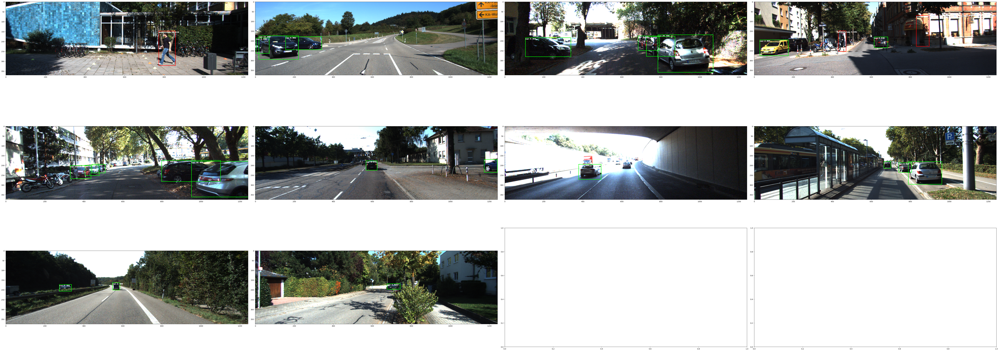

In [11]:
# Visualizing the first 12 images.
OUTPUT_PATH = 'tlt_infer_testing/images_annotated' # relative path from $USER_EXPERIMENT_DIR.
COLS = 4 # number of columns in the visualizer grid.
IMAGES = 12 # number of images to visualize.

visualize_images(OUTPUT_PATH, num_cols=COLS, num_images=IMAGES)

## 10. Model Export <a class="anchor" id="head-10"></a>

In [ ]:
!mkdir -p $LOCAL_EXPERIMENT_DIR/experiment_dir_final
# Removing a pre-existing copy of the onnx if there has been any.
import os
output_file=os.path.join(os.environ['LOCAL_EXPERIMENT_DIR'],
                         "experiment_dir_final/resnet18_detector.onnx")
if os.path.exists(output_file):
    os.system("rm {}".format(output_file))
!tao model detectnet_v2 export \
                  -m $USER_EXPERIMENT_DIR/experiment_dir_retrain/weights/resnet18_detector_pruned.hdf5 \
                  -e $SPECS_DIR/detectnet_v2_retrain_resnet18_kitti.txt \
                  -o $USER_EXPERIMENT_DIR/experiment_dir_final/resnet18_detector.onnx \
                  --onnx_route tf2onnx \
                  --gen_ds_config

Using the `tao deploy` container, you can generate a TensorRT engine and verify the correctness of the generated through evaluate and inference. 

The `tao deploy` produces optimized tensorrt engines for the platform that it resides on. Therefore, to get maximum performance, please run `tao deploy` command which will instantiate a deploy container, with the exported `.onnx` file on your target device. The `tao deploy` container only works for x86, with discrete NVIDIA GPU's. 

For the jetson devices, please download the tao-converter for jetson from the dev zone link [here](https://developer.nvidia.com/tao-converter). 

If you choose to integrate your model into deepstream directly, you may do so by simply copying the exported `.onnx` file along with the calibration cache to the target device and updating the spec file that configures the `gst-nvinfer` element to point to this newly exported model. Usually this file is called `config_infer_primary.txt` for detection models and `config_infer_secondary_*.txt` for classification models.

In [ ]:
# Need to pass the actual image directory instead of data root for tao deploy to locate images for calibration
!sed -i "s|/workspace/tao-experiments/data/training|/workspace/tao-experiments/data/training/image_2|g" $LOCAL_SPECS_DIR/detectnet_v2_retrain_resnet18_kitti.txt
# Convert to TensorRT engine (INT8)
!tao deploy detectnet_v2 gen_trt_engine \
                  -m $USER_EXPERIMENT_DIR/experiment_dir_final/resnet18_detector.onnx \
                  --data_type int8 \
                  --batches 10 \
                  --batch_size 4 \
                  --max_batch_size 64\
                  --engine_file $USER_EXPERIMENT_DIR/experiment_dir_final/resnet18_detector.trt.int8 \
                  --cal_cache_file $USER_EXPERIMENT_DIR/experiment_dir_final/calibration.bin \
                  -e $SPECS_DIR/detectnet_v2_retrain_resnet18_kitti.txt \
                  --results_dir $USER_EXPERIMENT_DIR/experiment_dir_final \
                  --verbose
# Convert back the spec file
!sed -i "s|/workspace/tao-experiments/data/training/image_2|/workspace/tao-experiments/data/training|g" $LOCAL_SPECS_DIR/detectnet_v2_retrain_resnet18_kitti.txt

*Note: For this example, we generate a calibration tensorfile containing 10 batches of training data.
Ideally, it is best to use at least 10-20% of the training data to do so. The more data provided during calibration, the closer int8 inferences are to fp32 inferences.*

*Note: If the model was trained with QAT nodes available, please refrain from using the post training int8 optimization as mentioned below. Please export the model in int8 mode (using the arg `--data_type int8`) with just the path to the calibration cache file (using the argument `--cal_cache_file`) and calibration json file (using the argument `--cal_json_file`)*

In [ ]:
print('Exported model:')
print('------------')
!ls -lh $LOCAL_EXPERIMENT_DIR/experiment_dir_final

## 11. Verify Deployed Model <a class="anchor" id="head-11"></a>
Verify the exported model by visualizing inferences on TensorRT.
In addition to running inference on a `.hdf5` model in [step 9](#head-9), the `inference` tool is also capable of consuming the converted `TensorRT engine` from [step 10.B](#head-10-2).

*If after int-8 calibration the accuracy of the int-8 inferences seem to degrade, it could be because the there wasn't enough data in the calibration tensorfile used to calibrate thee model or, the training data is not entirely representative of your test images, and the calibration maybe incorrect. Therefore, you may either regenerate the calibration tensorfile with more batches of the training data and recalibrate the model, or calibrate the model on a few images from the test set. This may be done using `--cal_image_dir` flag in the `tao deploy <task> gen_trt_engine` tool. For more information, please follow the instructions in the USER GUIDE.

### A. Inference using TensorRT engine <a class="anchor" id="head-11-1"></a>

In [ ]:
!tao deploy detectnet_v2 inference -e $SPECS_DIR/detectnet_v2_inference_kitti_etlt.txt \
                                   -m $USER_EXPERIMENT_DIR/experiment_dir_final/resnet18_detector.trt.int8 \
                                   -r $USER_EXPERIMENT_DIR/etlt_infer_testing \
                                   -i $DATA_DOWNLOAD_DIR/test_samples \
                                   -b 4

In [ ]:
# visualize the first 12 inferenced images.
OUTPUT_PATH = 'etlt_infer_testing/images_annotated' # relative path from $USER_EXPERIMENT_DIR.
COLS = 4 # number of columns in the visualizer grid.
IMAGES = 12 # number of images to visualize.

visualize_images(OUTPUT_PATH, num_cols=COLS, num_images=IMAGES)

## 11. QAT workflow <a class="anchor" id="head-12"></a>
This section delves into the newly enabled Quantization Aware Training feature with DetectNet_v2. The workflow defined below converts a pruned model from section [5](#head-5) to enable QAT and retrain this model to while accounting the noise introduced due to quantization in the forward pass. 

### A. Convert pruned model to QAT and retrain <a class="anchor" id="head-12-1"></a>
All detectnet models, unpruned and pruned models can be converted to QAT models by setting the `enable_qat` parameter in the `training_config` component of the spec file to `true`.

In [ ]:
# Printing the retrain experiment file. 
# Note: We have updated the experiment file to convert the
# pretrained model to qat mode by setting the enable_qat
# parameter.
!cat $LOCAL_SPECS_DIR/detectnet_v2_retrain_resnet18_kitti_qat.txt

In [ ]:
!tao model detectnet_v2 train -e $SPECS_DIR/detectnet_v2_retrain_resnet18_kitti_qat.txt \
                        -r $USER_EXPERIMENT_DIR/experiment_dir_retrain_qat \
                        -n resnet18_detector_pruned_qat \
                        --gpus $NUM_GPUS

In [ ]:
!ls -rlt $LOCAL_EXPERIMENT_DIR/experiment_dir_retrain_qat/weights

### B. Evaluate QAT converted model <a class="anchor" id="head-12-2"></a>
This section evaluates a QAT enabled pruned retrained model. The mAP of this model should be comparable to that of the pruned retrained model without QAT. However, due to quantization, it is possible sometimes to see a drop in the mAP value for certain datasets.

In [ ]:
!tao model detectnet_v2 evaluate -e $SPECS_DIR/detectnet_v2_retrain_resnet18_kitti_qat.txt \
                           -m $USER_EXPERIMENT_DIR/experiment_dir_retrain_qat/weights/resnet18_detector_pruned_qat.hdf5 \
                           -f tlt

### C. Export QAT trained model to int8 <a class="anchor" id="head-12-3"></a>
Export a QAT trained model to TensorRT parsable model. This command generates an .onnx file from the trained model and the serializes corresponding int8 scales as a TRT readable calibration cache file.

In [ ]:
!rm -rf $LOCAL_EXPERIMENT_DIR/experiment_dir_final/resnet18_detector_qat.onnx
!rm -rf $LOCAL_EXPERIMENT_DIR/experiment_dir_final/calibration_qat.bin
!tao model detectnet_v2 export \
                  -m $USER_EXPERIMENT_DIR/experiment_dir_retrain_qat/weights/resnet18_detector_pruned_qat.hdf5 \
                  -o $USER_EXPERIMENT_DIR/experiment_dir_final/resnet18_detector_qat.onnx \
                  -e $SPECS_DIR/detectnet_v2_retrain_resnet18_kitti_qat.txt \
                  --cal_json_file $USER_EXPERIMENT_DIR/experiment_dir_final/calibration_qat.json \
                  --gen_ds_config \
                  --onnx_route tf2onnx \
                  --verbose

In [ ]:
!tao deploy detectnet_v2 gen_trt_engine \
                  -m $USER_EXPERIMENT_DIR/experiment_dir_final/resnet18_detector_qat.onnx \
                  -e $SPECS_DIR/detectnet_v2_retrain_resnet18_kitti_qat.txt \
                  --data_type int8 \
                  --batch_size 64 \
                  --max_batch_size 64\
                  --engine_file $USER_EXPERIMENT_DIR/experiment_dir_final/resnet18_detector_qat.trt.int8 \
                  --cal_cache_file $USER_EXPERIMENT_DIR/experiment_dir_final/calibration_qat.bin \
                  --cal_json_file $USER_EXPERIMENT_DIR/experiment_dir_final/calibration_qat.json \
                  --results_dir $USER_EXPERIMENT_DIR/experiment_dir_final \
                  --verbose

### D. Evaluate a QAT trained model using the exported TensorRT engine <a class="anchor" id="head-12-4"></a>
This section evaluates a QAT enabled pruned retrained model using the TensorRT int8 engine that was exported in [Section C](#head-12-3). Please note that there maybe a slight difference (~0.1-0.5%) in the mAP from [Section B](#head-12-2), oweing to some differences in the implementation of quantization in TensorRT.

*Note: The TensorRT evaluator might be slightly slower than the TAO evaluator here, because the evaluation dataloader is pinned to the CPU to avoid any clashes between TensorRT and TAO instances in the GPU. Please note that this tool was not intended and has not been developed for profiling the model. It is just a means to qualitatively analyse the model.*

*Please use native TensorRT or DeepStream for the most optimized inferences.*

In [ ]:
import os
import shutil
val_split = 0.14  # Val split from the spec file
img_ext = '.png'
lab_ext = '.txt'

# Get images and labels from the partitioned validation set
images_root = f"{os.environ['LOCAL_DATA_DIR']}/training/image_2"
labels_root = f"{os.environ['LOCAL_DATA_DIR']}/training/label_2"
images_list = [os.path.splitext(imfile)[0] for imfile in sorted(os.listdir(images_root)) if imfile.endswith(img_ext)]
num_val_images = int(len(images_list) * val_split)

# Copy the data to a separate directory for evaluation
os.makedirs(os.path.join(f"{os.environ['LOCAL_DATA_DIR']}/training", "images_val"), exist_ok=True)
os.makedirs(os.path.join(f"{os.environ['LOCAL_DATA_DIR']}/training", "labels_val"), exist_ok=True)

for fname in images_list[:num_val_images]:
    shutil.copyfile(os.path.join(images_root, fname + img_ext), \
                             os.path.join(f"{os.environ['LOCAL_DATA_DIR']}/training", "images_val", fname + img_ext))
    shutil.copyfile(os.path.join(labels_root, fname + lab_ext), \
                             os.path.join(f"{os.environ['LOCAL_DATA_DIR']}/training", "labels_val", fname + lab_ext))

In [ ]:
!tao deploy detectnet_v2 evaluate -e $SPECS_DIR/detectnet_v2_retrain_resnet18_kitti_qat.txt \
                                  -m $USER_EXPERIMENT_DIR/experiment_dir_final/resnet18_detector_qat.trt.int8 \
                                  -i $DATA_DOWNLOAD_DIR/training/images_val \
                                  -l $DATA_DOWNLOAD_DIR/training/labels_val \
                                  -r $USER_EXPERIMENT_DIR/experiment_dir_retrain_qat/

### E. Inference using QAT engine <a class="anchor" id="head-12-5"></a>
Run inference and visualize detections on test images, using the exported TensorRT engine from [Section C](#head-12-3).

In [ ]:
!tao deploy detectnet_v2 inference -e $SPECS_DIR/detectnet_v2_inference_kitti_etlt_qat.txt \
                                   -m $USER_EXPERIMENT_DIR/experiment_dir_final/resnet18_detector_qat.trt.int8 \
                                   -r $USER_EXPERIMENT_DIR/tlt_infer_testing_qat \
                                   -i $DATA_DOWNLOAD_DIR/test_samples \
                                   -b 4

In [ ]:
# visualize the first 12 inferenced images.
OUTPUT_PATH = 'tlt_infer_testing_qat/images_annotated' # relative path from $USER_EXPERIMENT_DIR.
COLS = 4 # number of columns in the visualizer grid.
IMAGES = 12 # number of images to visualize.

visualize_images(OUTPUT_PATH, num_cols=COLS, num_images=IMAGES)